<div style="display:block" direction=rtl align=right><br><br>
    <div  style="width:100%;margin:100;display:block"  display=block align=center>
        <img width=130 align=right src="https://i.ibb.co/yXKQmtZ/logo1.png" style="margin:0;" />
        <img width=170 align=left  src="https://i.ibb.co/wLjqFkw/logo2.png" style="margin:0;" />
        <span><br><font size=5>University of Tehran , school of ECE</font></span>
        <span><br><font size=3>Deep Generative Models Course</font></span>
        <span><br><font size=3>Fall 2023</font></span>
    </div><br><br><br>
    <div style="display:block" align=left display=block>
</div>

# Working with GANs using PyTorch

This notebook is a homework assignment for the Deep Generative Models course at the University of Tehran. The goal of this assignment is to get familiar with the concept of Generative Adversarial Networks (GANs) and how to implement it with PyTorch. We will use the MNIST dataset for this assignment.

---


**Requisites**

*   Python 3.x
*   Jupyter
*   PyTorch >= 1.8
*   NumPy
*   Matplotlib
---

In [1]:
!nvidia-smi

Fri Dec 22 21:43:51 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 546.29                 Driver Version: 546.29       CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 3060 ...  WDDM  | 00000000:01:00.0 Off |                  N/A |
| N/A   47C    P0              22W / 132W |      0MiB /  6144MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# **Import Libraries:**

Import your required libraries!

In [2]:
import torch
import torch.nn as nn
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torch.optim as optim
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import torchvision

import argparse
import numpy as np
import os
import torch
import torchvision
from torch import nn, optim
from torch.nn import functional as F
from torchvision.utils import save_image
from tqdm import tqdm
import torchvision.utils as vutils

from torch import autograd, nn, optim
from torch.nn import functional as F

import argparse
from pprint import pprint
from torchvision import datasets, transforms

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
torch.manual_seed(42) # using last two digits of Student No. for random seed (810102042)

## **Downloading the dataset:**

We will use the MNIST dataset for this assignment. The dataset is already available in PyTorch, so we just need to download it.

In [4]:
preprocess = transforms.ToTensor()
train_loader = torch.utils.data.DataLoader(
            datasets.MNIST(root='./data', train=True, download=True, transform=preprocess),
            batch_size=128,
            shuffle=True
        )
test_loader = torch.utils.data.DataLoader(
            datasets.MNIST(root='./data', train=False, download=True, transform=preprocess),
            batch_size=128,
            shuffle=True
        )

## **Define Generator:**

We will use a simple 5-layer convolutional neural network for this assignment. The network is defined in the `Net` class below. The network is composed of 3 convolutional layers and 2 fully connected layers.

In [5]:
class Generator(torch.nn.Module):
    def __init__(self, z_dim=64, num_channels=1):
        super().__init__()
        self.z_dim = z_dim

        ############################# TODO #############################
        # Complete this part according to the introduced generator table on the provided manuscript!

        # YOUR CODE STARTS HERE
        self.layer1 = nn.Sequential(
                    nn.Linear(z_dim, 512),
                    nn.BatchNorm1d(512),
                    nn.ReLU())
        self.layer2 = nn.Sequential(
                    nn.Linear(512, 3136),
                    nn.BatchNorm1d(3136),     
                    nn.ReLU())
        self.layer3 = nn.Sequential(
                    nn.PixelShuffle(2))
        self.layer4 = nn.Sequential(
                    nn.Conv2d(16, 32, kernel_size=3, padding=1),
                    nn.BatchNorm2d(32),
                    nn.ReLU())
        self.layer5 = nn.Sequential(
                    nn.PixelShuffle(2))
        self.layer6 = nn.Sequential(
                    nn.Conv2d(8, 1, kernel_size=3, padding=1))
        # YOUR CODE ENDS HERE

    def forward(self, z):
        z = self.layer1(z)
        z = self.layer2(z)
        z = z.reshape(z.size(0), 64, 7, 7)
        z = self.layer3(z)
        z = self.layer4(z)
        z = self.layer5(z)
        output = self.layer6(z)
        return output

## **Define Discriminator:**

We will use a simple 5-layer convolutional neural network for this assignment. The network is defined in the `Net` class below. The network is composed of 3 convolutional layers and 2 fully connected layers.

In [6]:
class Discriminator(torch.nn.Module):
    def __init__(self, num_channels=1):
        super().__init__()

        ############################# TODO #############################
        # Complete this part according to the introduced discriminator table on the provided manuscript!

        # YOUR CODE STARTS HERE
        self.layer1 = nn.Sequential(
                    nn.Conv2d(1, 32, kernel_size=4, stride=2, padding=1),
                    nn.ReLU())
        self.layer2 = nn.Sequential(
                    nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1),
                    nn.ReLU())
        self.layer3 = nn.Sequential(
                    nn.Linear(3136, 512),
                    nn.ReLU())
        self.layer4 = nn.Sequential(
                    nn.Linear(512, 1),
                    nn.Sigmoid())


        # YOUR CODE ENDS HERE

    def forward(self, x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = x.reshape(x.size(0), 3136)
        x = self.layer3(x)
        output = self.layer4(x)
        return output

## **Define Your GAN:**

In [7]:
class GAN(nn.Module):
    def __init__(self, z_dim=64):
        super().__init__()
        self.z_dim = z_dim
        self.g = Generator(z_dim=z_dim)
        self.g = self.g.to(device)
        self.d = Discriminator()   # note that discriminator outputs logits
        self.d = self.d.to(device)
        self.criterion = nn.BCELoss()
    def loss_nonsaturating(self, x_real):
        '''
        Input Arguments:

        - x_real (torch.Tensor): training data samples (64, 1, 28, 28)
        - device (torch.device): 'cpu' by default

        Returns:
        - d_loss (torch.Tensor): nonsaturating discriminator loss
        - g_loss (torch.Tensor): nonsaturating generator loss
        '''

        ############################# TODO #############################
        # YOUR CODE STARTS HERE
        batch_size = x_real.size(0)
        real_labels = torch.ones(batch_size, 1).to(device)
        fake_labels = torch.zeros(batch_size, 1).to(device)

        real_outputs = self.d(x_real)
        real_loss = self.criterion(real_outputs, real_labels)

        noise = torch.randn(batch_size, 64).to(device)
        fake_images = self.g(noise)
        fake_outputs = self.d(fake_images.detach())
        fake_loss = self.criterion(fake_outputs, fake_labels)

        d_loss = real_loss + fake_loss
        noise = torch.randn(batch_size, 64).to(device)
        # fake_images = generator(noise)
        fake_outputs = self.d(fake_images)
        g_loss = self.criterion(fake_outputs, real_labels)
        # YOUR CODE ENDS HERE


        return d_loss, g_loss

## **Training Process:**

In [8]:

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

class Trainer:
    def __init__(self,
                 model,
                 optimizers,
                 iter_max=10000,
                 iter_save=5,
                 num_latents=64,
                 out_dir=""
            ):
        self.model = model
        self.optimizers = optimizers
        self.iter_save = iter_save
        self.iter_max = iter_max
        self.out_dir = out_dir
        self.num_latents = num_latents
        self.G_losses = []
        self.D_losses = []

        # fix visualization latents
        self.z_test = torch.randn(100, self.num_latents).to(device)


    def build_input(self, x, y):
        x_real = x.to(device)
        y_real = y.to(device)
        return x_real, y_real

    def viz(self, global_step):
        with torch.no_grad():
            generator = self.model.g
            generator.eval()
            ############
            fake = ((generator(self.z_test) + 1) / 2.) #.detach().cpu()
            ###############
            generator.train()
        torchvision.utils.save_image(fake, '%s/fake_%04d.png' % (self.out_dir, global_step), nrow=10, padding=2, normalize=True)
        img_list.append(vutils.make_grid(fake, padding=2, normalize=True, nrow=10))


    def checkpoint_and_log(self, global_step, loss, summaries):
        if global_step % self.iter_save == 0:
            with torch.no_grad():
                self.viz(global_step)
                torch.save((self.model.g, self.model.d), '%s/model_%04d.pt' % (self.out_dir, global_step))


    def gan_step(self, x_real, global_step):
        assert len(self.optimizers) == 2


        ############################# TODO #############################
        # Here you should calculate the loss for both the generator and discriminator parts!
        # After that, you have to apply this calculated loss to both the networks and update their weights respectively.
        # Here you have to use the "checkpoint_and_log" function in order to visualize and make checkpoint from your model!

        # YOUR CODE STARTS HERE
        # Calculate losses
        d_loss, g_loss = self.model.loss_nonsaturating(x_real)
        # discriminator step
        self.optimizers[1].zero_grad()
        d_loss.backward()
        self.optimizers[1].step()
        # generator step
        d_loss, g_loss = self.model.loss_nonsaturating(x_real)
        self.optimizers[0].zero_grad()
        g_loss.backward()
        self.optimizers[0].step()
        # checkpoint_and_log
        if global_step == 2 or global_step == self.iter_max or global_step == int(self.iter_max/2) or global_step == int(self.iter_max/5):
            with torch.no_grad():
                self.viz(global_step)
                torch.save((self.model.g, self.model.d), '%s/model_%04d.pt' % (self.out_dir, global_step))

        # YOUR CODE ENDS HERE

        return d_loss.detach().cpu().numpy(), g_loss.detach().cpu().numpy()



    def train(self, train_loader):
        global_step = 0

        # train models for multiple epochs
        # with tqdm(total=int(self.iter_max)) as pbar:
        for i in tqdm(range(self.iter_max)):
            ############################# TODO #############################
            # Here is your training loop!
            # YOUR CODE STARTS HERE
            global_step += 1
            for i, (x_real, _) in enumerate(train_loader):
                x_real = x_real.to(device)
                d_loss, g_loss = self.gan_step(x_real, global_step)
                self.G_losses.append(g_loss)
                self.D_losses.append(d_loss)

            # YOUR CODE ENDS HERE
            pass

In [9]:
def build_model(num_latents=64):
    model = GAN(z_dim=num_latents)
    return model.to(device)


def build_optimizers(model):
    g_opt = torch.optim.Adam(model.g.parameters(), lr=2e-4)
    d_opt = torch.optim.Adam(model.d.parameters(), lr=2e-4)
    optimizers = [g_opt, d_opt]
    return optimizers


num_latents = 64
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
model = build_model(num_latents=num_latents)
optimizers = build_optimizers(model)


trainer = Trainer(model, optimizers,
                    iter_max=50,
                    num_latents=num_latents,
                    out_dir='./'
                  )

trainer.train(train_loader)

trainer.viz(50)

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [09:44<00:00, 11.70s/it]


## **Plot Losses:**

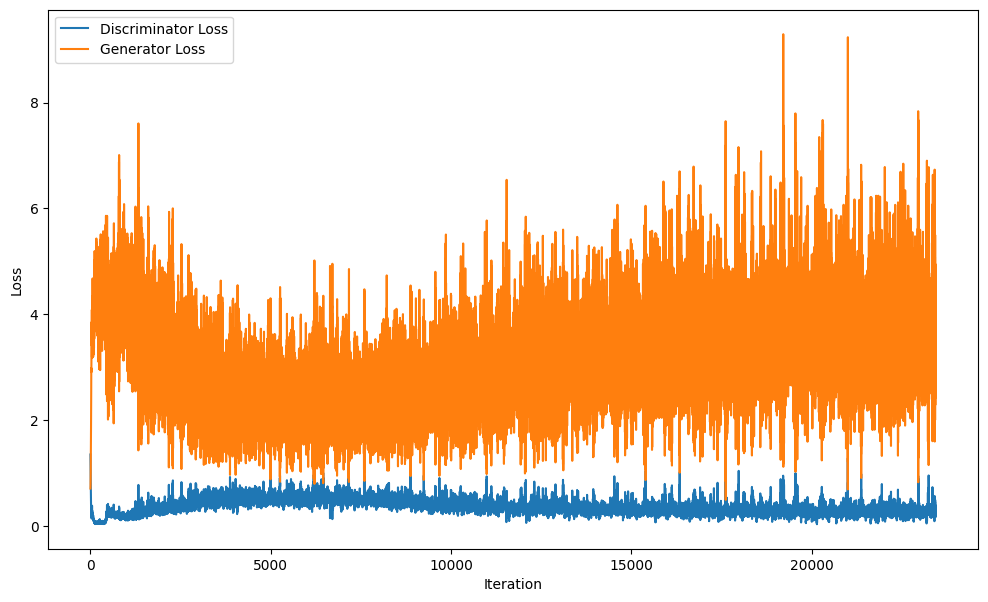

In [10]:
############################# TODO #############################
# Here, you should use the "G_losses", and "D_losses" in order to plot the "Loss Values Variation Diagram".

# YOUR CODE STARTS HERE
plt.figure(figsize=(12,7))
plt.plot(trainer.D_losses)
plt.plot(trainer.G_losses)
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.legend(['Discriminator Loss','Generator Loss'])
plt.show()


# YOUR CODE ENDS HERE

## **Visualization:**

By using the "img_list" you can visualize the animation of changes that occurred during training.

In [11]:
len(img_list)

1877

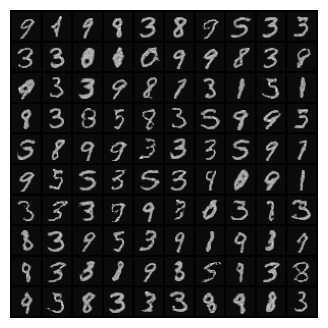

In [12]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(4, 4))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i.detach().cpu(), (1,2,0)), animated=True)] for i in img_list[0::10]]
ani = animation.ArtistAnimation(fig, ims, interval=5000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

In [13]:
torch.cuda.empty_cache()

In [ ]:
from pytorch_fid import fid_score
from torchvision.utils import save_image
from torch.utils.data import DataLoader
from pytorch_fid.inception import InceptionV3
from torch.utils.data import TensorDataset, DataLoader

z_test = torch.randn(1000, 64).to(device)
x_gen = model.g(z_test)
dataset_gen = TensorDataset(x_gen)
fake_loader = DataLoader(dataset_gen, batch_size=32, shuffle=True)
# Function to calculate the Inception-v3 features
def calculate_activation_statistics(data_loader, inception_model, device):
    all_features = []

    for batch in data_loader:
        if data_loader == fake_loader:
            images = batch[0]
        else:
            images, _ = batch
        images = images.to(device)
        images = images.expand(-1, 3, -1, -1)
        # Get Inception-v3 features
        features = inception_model(images)[0].view(images.size(0), -1)
        all_features.append(features.detach().cpu().numpy())
        torch.cuda.empty_cache()
    all_features = np.concatenate(all_features, axis=0)
    mu = np.mean(all_features, axis=0)
    sigma = np.cov(all_features, rowvar=False)

    return mu, sigma

# Set up Inception model for feature extraction (modified for grayscale images)
inception_model = InceptionV3([InceptionV3.BLOCK_INDEX_BY_DIM[2048]], normalize_input=False)
inception_model.to(device)
inception_model.eval()


real_mu, real_sigma = calculate_activation_statistics(train_loader, inception_model, device)
fake_mu, fake_sigma = calculate_activation_statistics(fake_loader, inception_model, device)




In [27]:
fid_score_value = np.linalg.norm(real_mu-fake_mu)+np.trace(np.sqrt(np.abs(real_sigma*fake_sigma))*0.5)
print(f"FID Score: {fid_score_value:.4f}")

FID Score: 51.3772
